## Install lightning

In [ ]:
!pip install pytorch_lightning
!pip install torch_lr_finder

## Import files from drive

In [1]:
from google.colab import drive
drive.mount('/content/gdrive/')
%cd /content/gdrive/My\ Drive/Assignment_od/

ModuleNotFoundError: No module named 'google.colab'

## Unzip Pascal voc dataset

In [2]:
import zipfile
zip_ref = zipfile.ZipFile("Pascal_dataset.zip", 'r')
zip_ref.extractall("/content")
zip_ref.close()

## Manage Imports

In [1]:
# imports
import os

import torch
from torch import nn
from torchvision import transforms
from torchsummary import summary
import config
from Model.model import YOLOv3
from tqdm import tqdm
from torch.optim.lr_scheduler import OneCycleLR
from torch.utils.data import DataLoader
from torch.optim.lr_scheduler import StepLR

## Pytorch lightning module

In [2]:
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
import torch.optim.lr_scheduler as lr_scheduler
from Model.Moduli import Yolov3_module

/opt/conda/lib/python3.7/site-packages/pkg_resources/__init__.py:119: PkgResourcesDeprecationWarning: 4.0.0-unsupported is an invalid version and will not be supported in a future release
  PkgResourcesDeprecationWarning,
/opt/conda/lib/python3.7/site-packages/pkg_resources/__init__.py:119: PkgResourcesDeprecationWarning: 4.0.0-unsupported is an invalid version and will not be supported in a future release
  PkgResourcesDeprecationWarning,


## Run lr_finder

  0%|          | 0/200 [00:00<?, ?it/s]

Stopping early, the loss has diverged
Learning rate search finished. See the graph with {finder_name}.plot()
LR suggestion: steepest gradient
Suggested LR: 1.76E-02


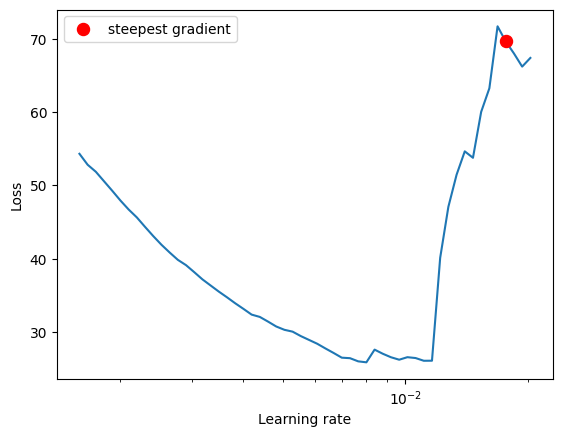

In [4]:
from torch_lr_finder import LRFinder
model = Yolov3_module()
optimizer = torch.optim.Adam(model.parameters(), lr=config.LEARNING_RATE, weight_decay=config.WEIGHT_DECAY)
train_dataset = YOLODataset(
          config.DATASET + "/train.csv",
          transform=config.train_transforms,
          S=[config.IMAGE_SIZE // 32, config.IMAGE_SIZE // 16, config.IMAGE_SIZE // 8],
          img_dir=config.IMG_DIR,
          label_dir=config.LABEL_DIR,
          anchors=config.ANCHORS,
          )
train_dataloader = DataLoader(train_dataset, batch_size=config.BATCH_SIZE, num_workers=config.NUM_WORKERS)
loss_fn = model.loss
def criterion(out, y):
    y0, y1, y2 = (
            y[0].to(DEVICE),
            y[1].to(DEVICE),
            y[2].to(DEVICE),
        )
    loss = (
                loss_fn(out[0], y0, model.scaled_anchors[0])
                + loss_fn(out[1], y1, model.scaled_anchors[1])
                + loss_fn(out[2], y2, model.scaled_anchors[2])
            )
    return loss
lr_finder = LRFinder(model, optimizer, criterion, device="cuda")
lr_finder.range_test(train_dataloader, end_lr=10, num_iter=200, step_mode="exp")
lr_finder.plot() # to inspect the loss-learning rate graph
lr_finder.reset() # to reset the model and optimizer to their initial state

## Run trainer for 40 epochs 

Using 16bit None Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2,3]

  | Name     | Type               | Params
------------------------------------------------
0 | model    | YOLOv3             | 61.6 M
1 | loss     | YoloLoss           | 0     
2 | accuracy | MulticlassAccuracy | 0     
------------------------------------------------
61.6 M    Trainable params
0         Non-trainable params
61.6 M    Total params
123.253   Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

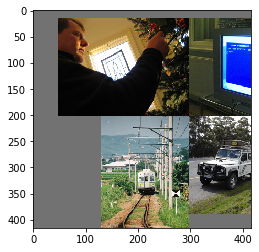

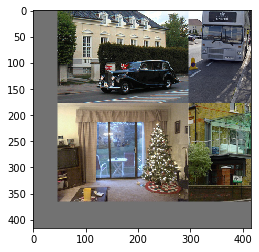

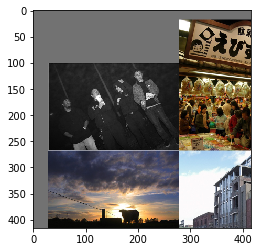

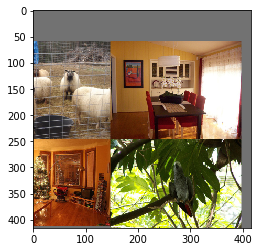

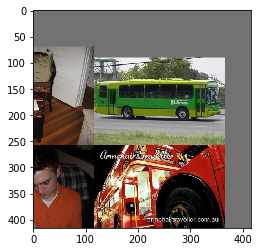

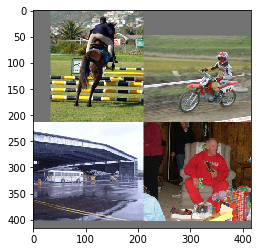

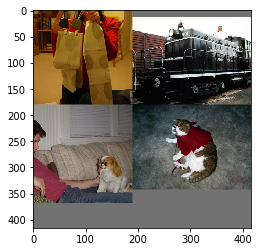

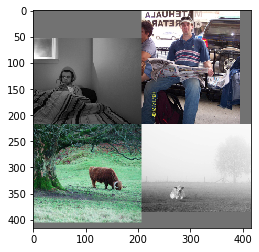

Current learning rate: 1e-05
Currently epoch 0
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 6.351440%
No obj accuracy is: 0.000000%
Obj accuracy is: 100.000000%
=> Saving checkpoint


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

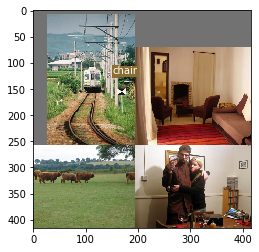

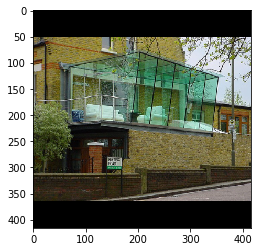

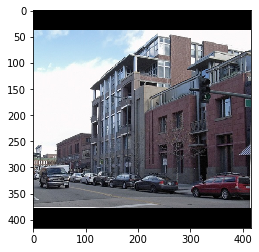

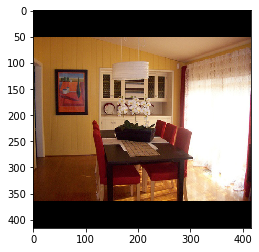

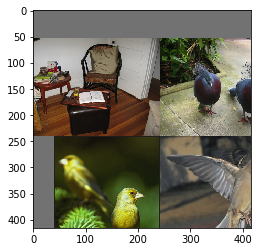

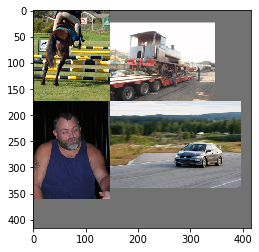

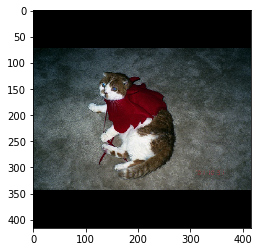

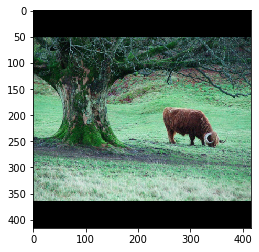

Current learning rate: 0.00014749999999999998
Currently epoch 0
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 28.598600%
No obj accuracy is: 0.029351%
Obj accuracy is: 99.850609%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

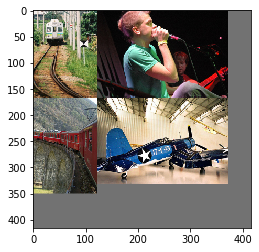

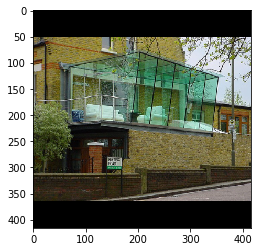

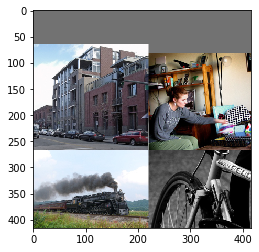

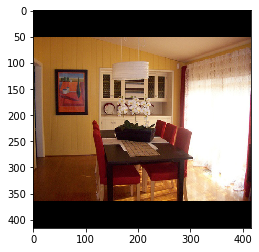

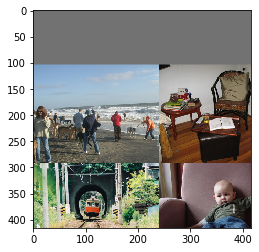

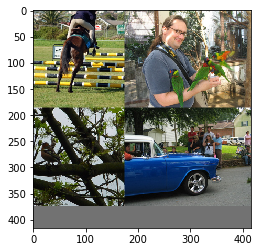

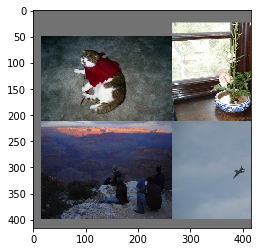

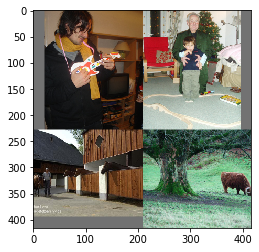

Current learning rate: 0.000285
Currently epoch 1
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 33.689621%
No obj accuracy is: 87.437164%
Obj accuracy is: 20.744902%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

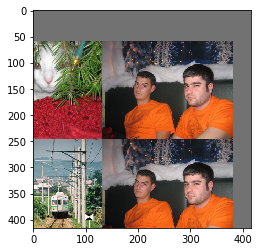

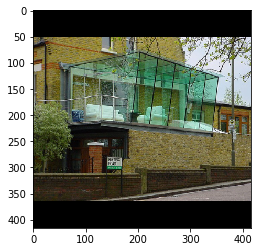

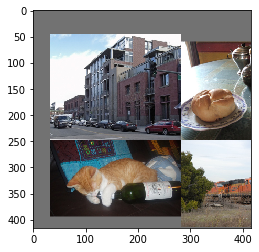

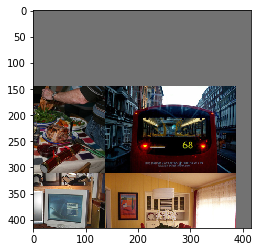

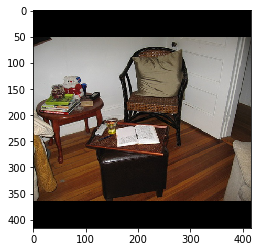

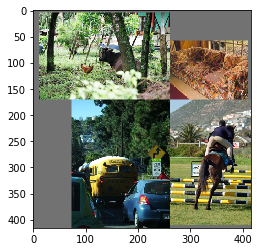

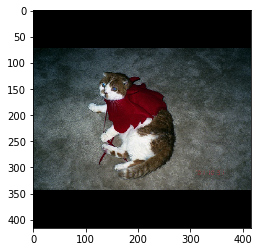

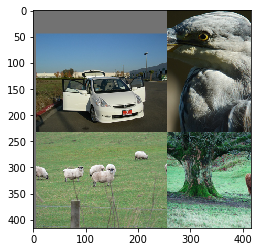

Current learning rate: 0.00042249999999999997
Currently epoch 2
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 36.301552%
No obj accuracy is: 99.117432%
Obj accuracy is: 5.730172%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

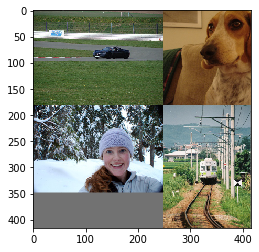

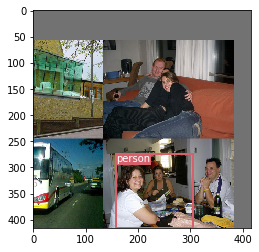

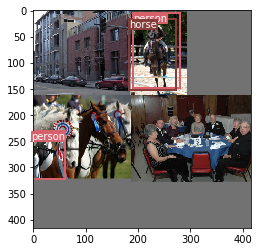

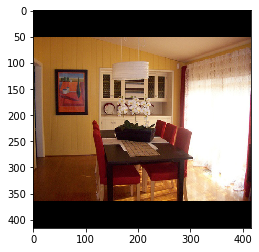

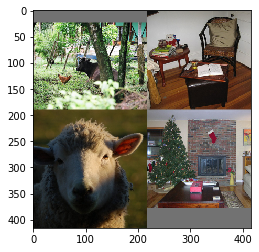

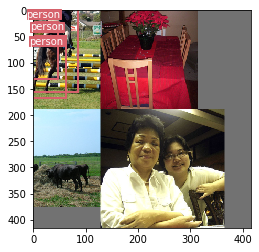

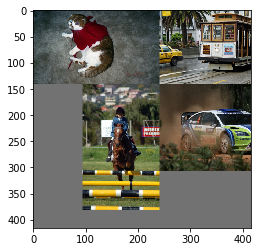

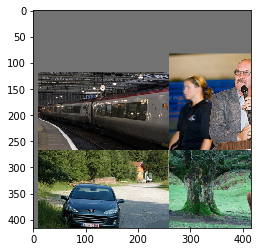

Current learning rate: 0.00056
Currently epoch 3
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 40.208767%
No obj accuracy is: 97.319244%
Obj accuracy is: 27.323669%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

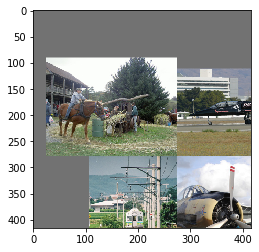

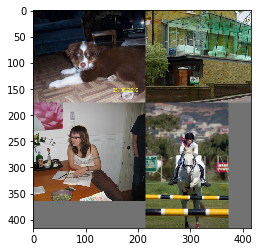

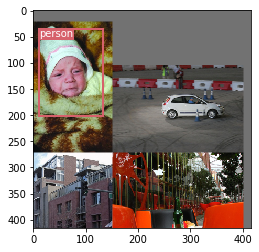

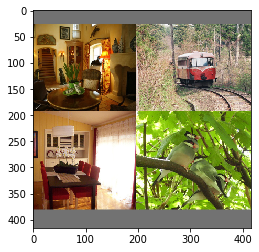

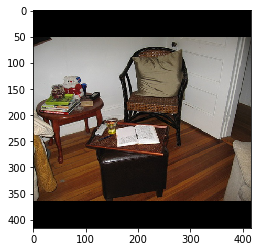

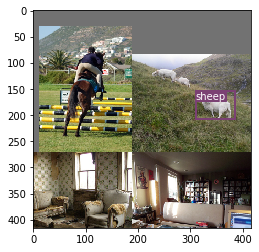

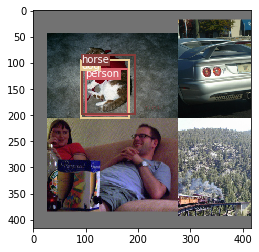

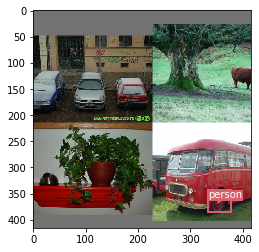

Current learning rate: 0.0006974999999999999
Currently epoch 4
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 36.940189%
No obj accuracy is: 96.828369%
Obj accuracy is: 35.473351%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

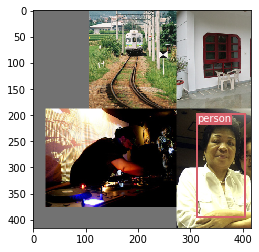

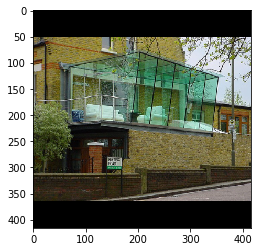

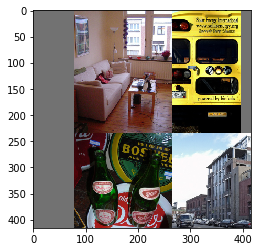

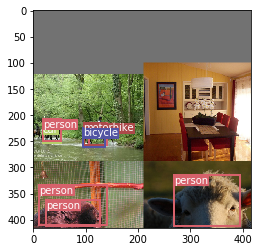

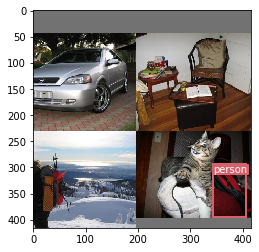

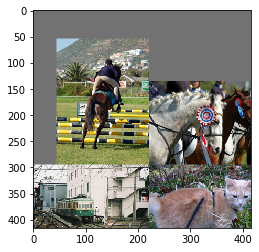

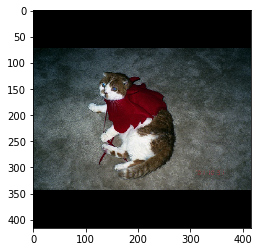

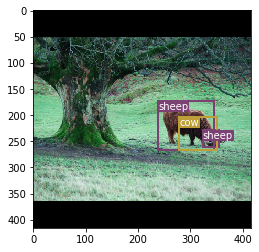

Current learning rate: 0.0008349999999999999
Currently epoch 5
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 42.820984%
No obj accuracy is: 97.190842%
Obj accuracy is: 43.995888%
=> Saving checkpoint
~~~~~~~~~Evaluating for val set~~~~~~~~~~~~~~~


  0%|          | 0/155 [00:00<?, ?it/s]

Class accuracy is: 46.189587%
No obj accuracy is: 97.202850%
Obj accuracy is: 41.695999%


  0%|          | 0/155 [00:00<?, ?it/s]

MAP: 0.043425705283880234


Validation: 0it [00:00, ?it/s]

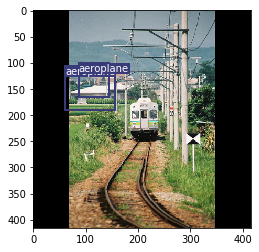

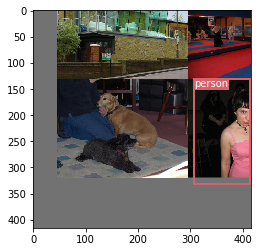

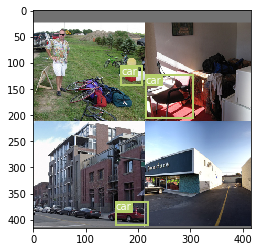

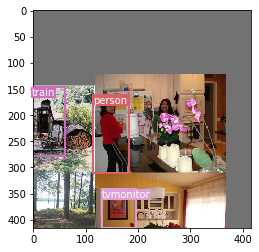

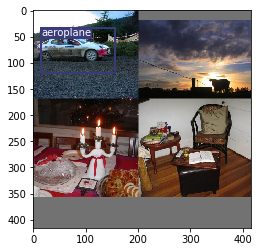

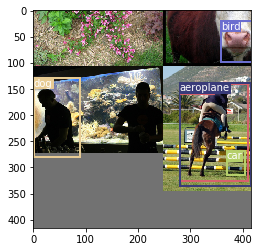

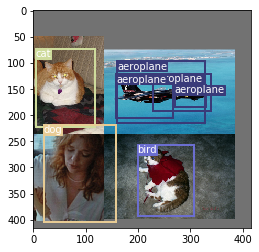

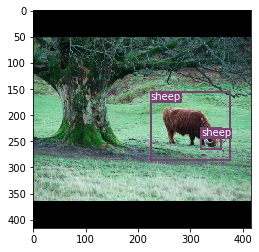

Current learning rate: 0.0009725
Currently epoch 6
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 40.152962%
No obj accuracy is: 97.504234%
Obj accuracy is: 44.871758%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

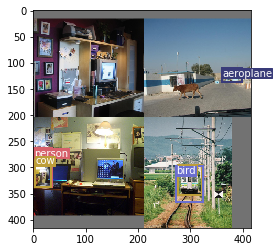

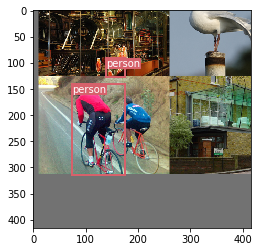

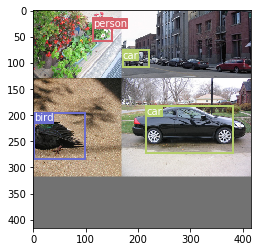

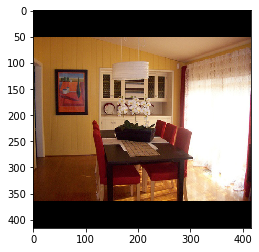

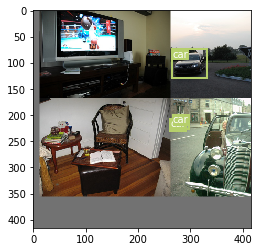

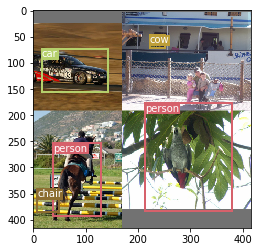

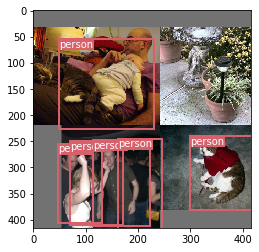

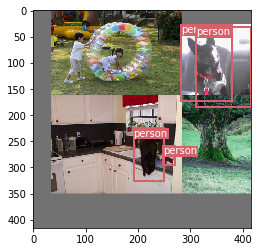

Current learning rate: 0.0009756121951219513
Currently epoch 7
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 48.217766%
No obj accuracy is: 96.195473%
Obj accuracy is: 59.413124%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

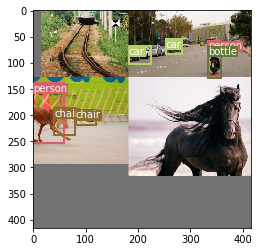

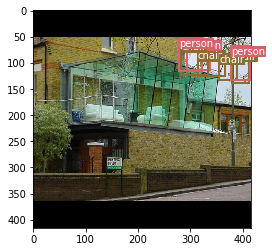

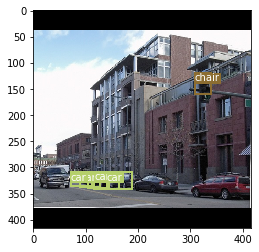

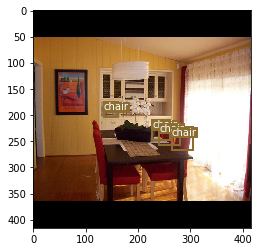

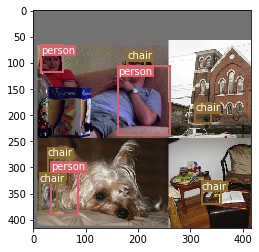

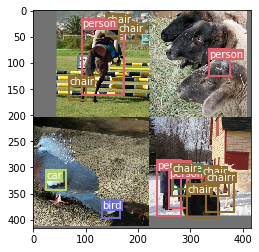

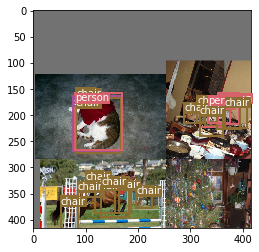

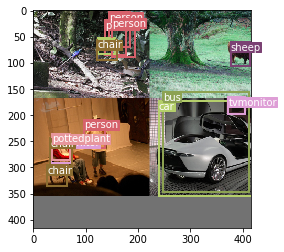

Current learning rate: 0.0009451274390243903
Currently epoch 8
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 38.846565%
No obj accuracy is: 95.179794%
Obj accuracy is: 52.499950%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

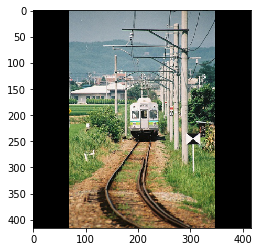

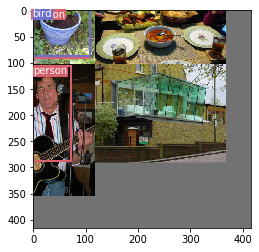

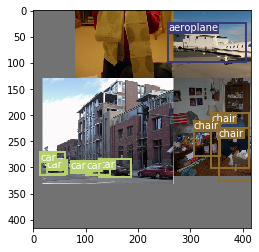

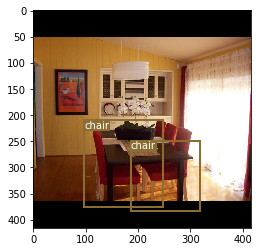

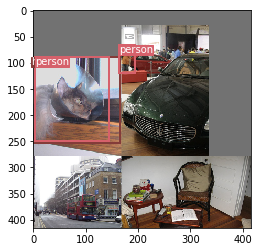

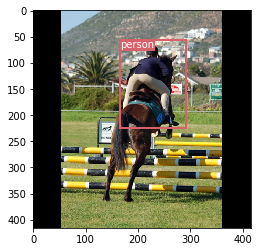

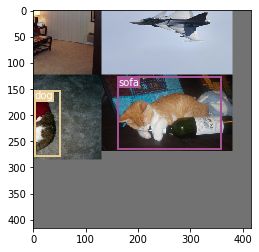

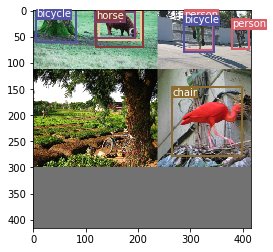

Current learning rate: 0.0009146426829268294
Currently epoch 9
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 49.704792%
No obj accuracy is: 97.277054%
Obj accuracy is: 54.947449%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

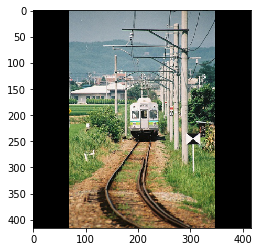

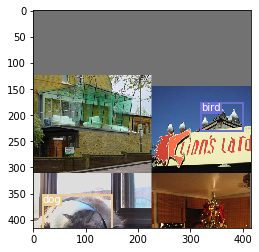

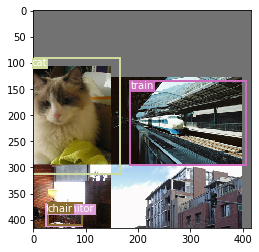

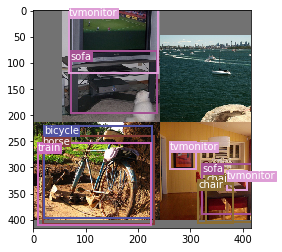

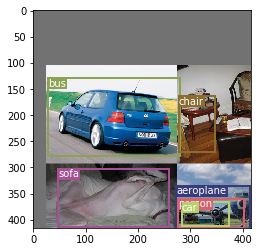

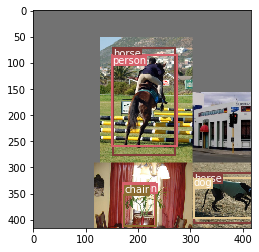

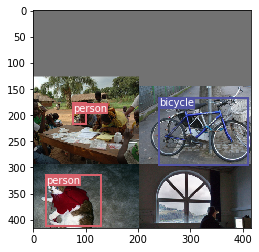

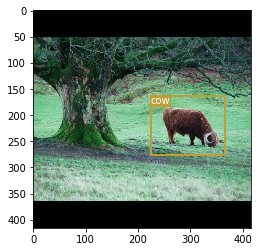

Current learning rate: 0.0008841579268292683
Currently epoch 10
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 53.374588%
No obj accuracy is: 97.092987%
Obj accuracy is: 60.657207%
=> Saving checkpoint
~~~~~~~~~Evaluating for val set~~~~~~~~~~~~~~~


  0%|          | 0/155 [00:00<?, ?it/s]

Class accuracy is: 56.763088%
No obj accuracy is: 96.893478%
Obj accuracy is: 61.217953%


  0%|          | 0/155 [00:00<?, ?it/s]

MAP: 0.15017850697040558


Validation: 0it [00:00, ?it/s]

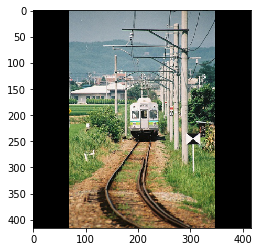

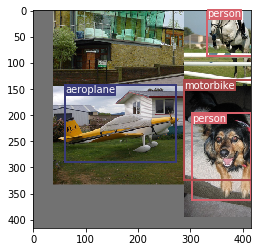

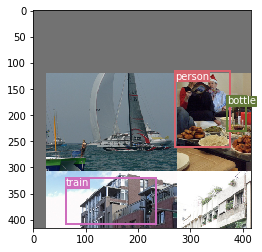

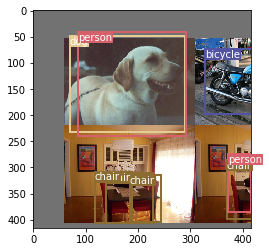

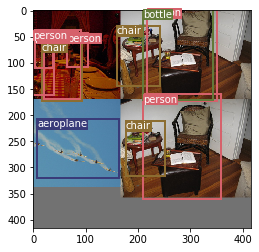

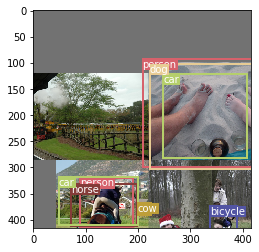

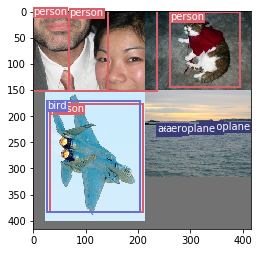

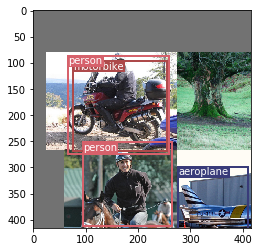

Current learning rate: 0.0008536731707317073
Currently epoch 11
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 54.702015%
No obj accuracy is: 97.158585%
Obj accuracy is: 57.332432%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

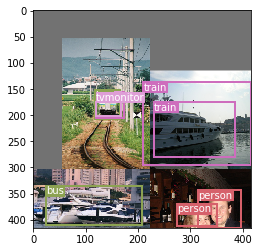

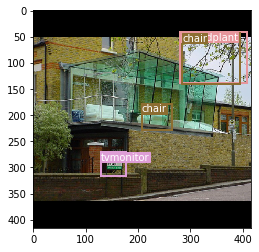

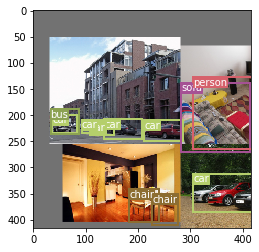

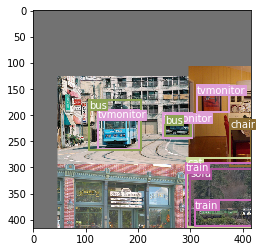

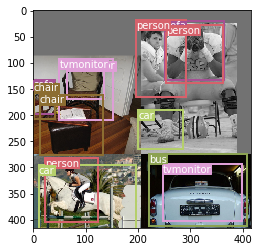

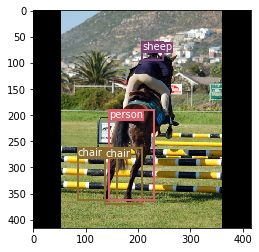

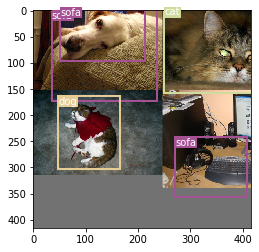

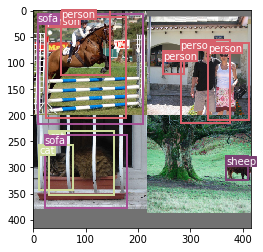

Current learning rate: 0.0008231884146341463
Currently epoch 12
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 54.492569%
No obj accuracy is: 96.118439%
Obj accuracy is: 67.014221%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

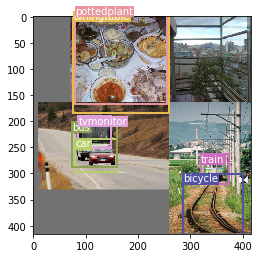

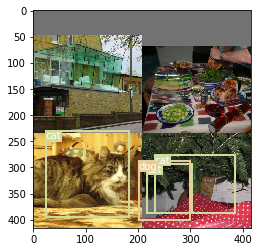

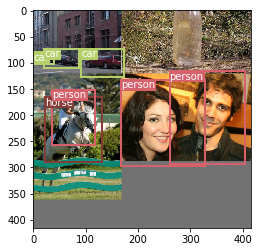

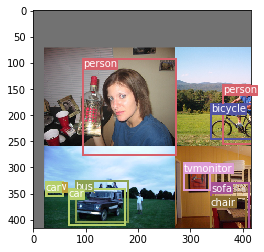

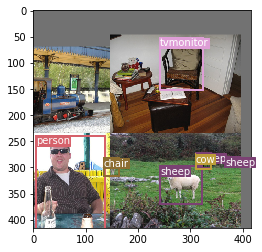

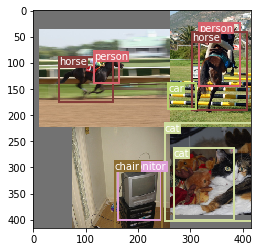

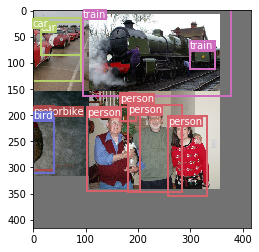

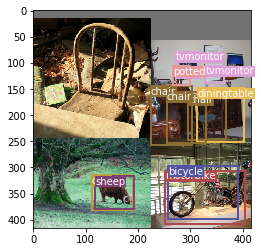

Current learning rate: 0.0007927036585365854
Currently epoch 13
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 61.190437%
No obj accuracy is: 97.127167%
Obj accuracy is: 65.358955%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

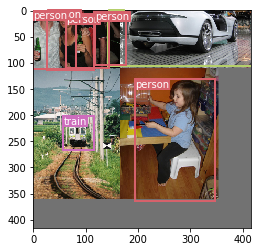

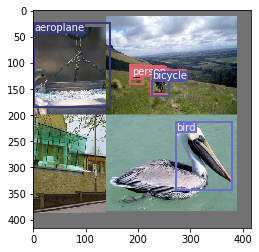

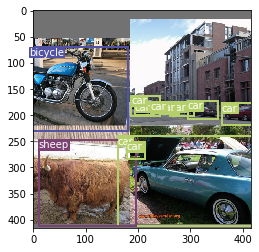

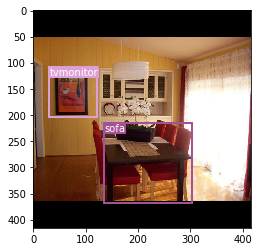

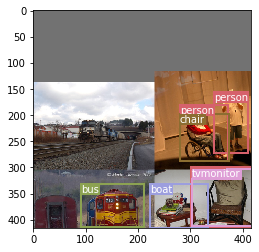

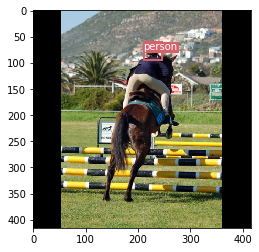

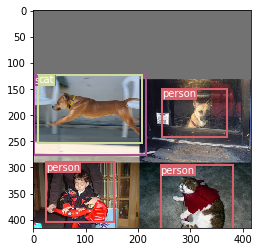

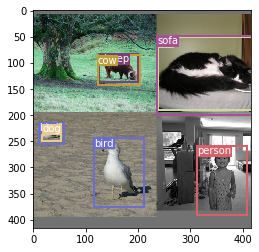

Current learning rate: 0.0007622189024390244
Currently epoch 14
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 60.863071%
No obj accuracy is: 97.348114%
Obj accuracy is: 65.239510%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

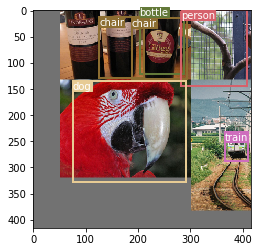

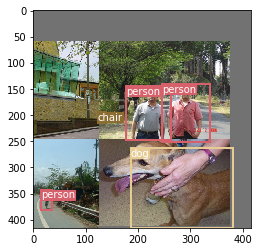

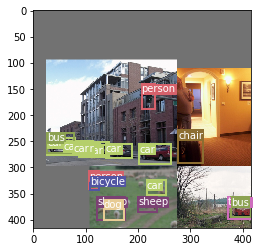

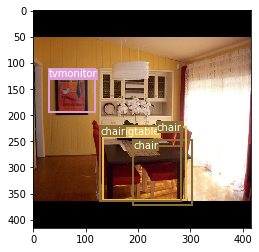

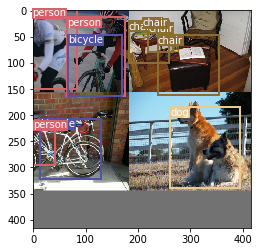

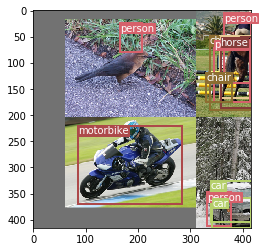

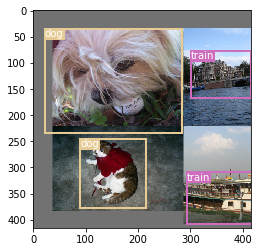

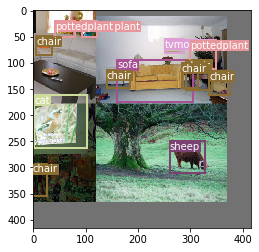

Current learning rate: 0.0007317341463414634
Currently epoch 15
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 58.163643%
No obj accuracy is: 96.748314%
Obj accuracy is: 68.417915%
=> Saving checkpoint
~~~~~~~~~Evaluating for val set~~~~~~~~~~~~~~~


  0%|          | 0/155 [00:00<?, ?it/s]

Class accuracy is: 62.577744%
No obj accuracy is: 96.397804%
Obj accuracy is: 69.899895%


  0%|          | 0/155 [00:00<?, ?it/s]

MAP: 0.19631698727607727


Validation: 0it [00:00, ?it/s]

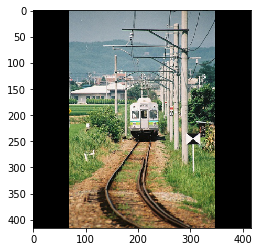

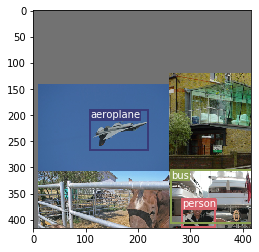

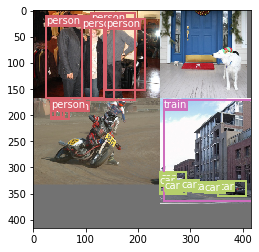

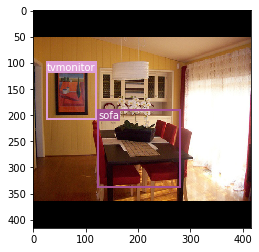

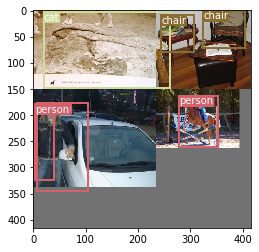

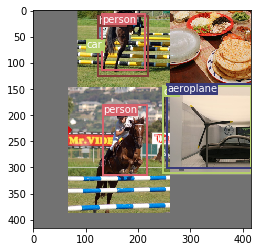

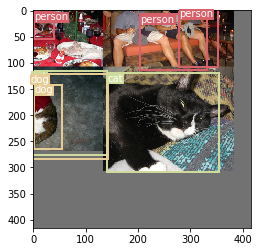

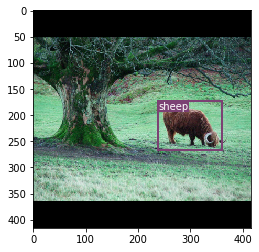

Current learning rate: 0.0007012493902439024
Currently epoch 16
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 63.148540%
No obj accuracy is: 97.620628%
Obj accuracy is: 63.720810%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

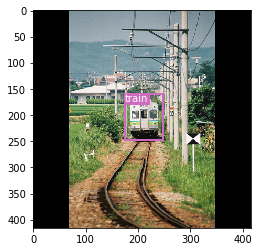

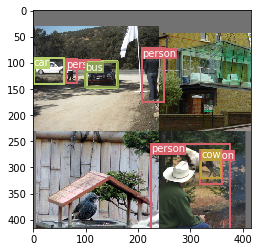

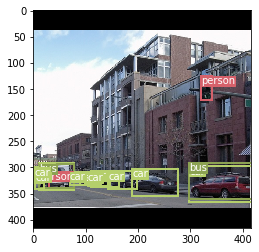

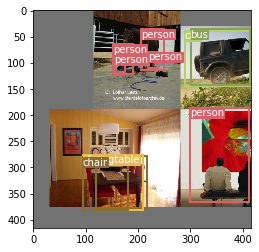

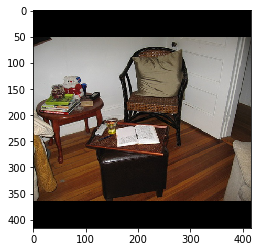

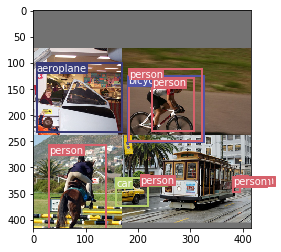

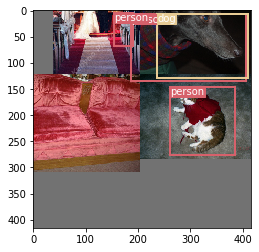

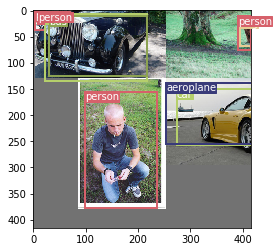

Current learning rate: 0.0006707646341463415
Currently epoch 17
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 61.242538%
No obj accuracy is: 97.294106%
Obj accuracy is: 68.211388%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

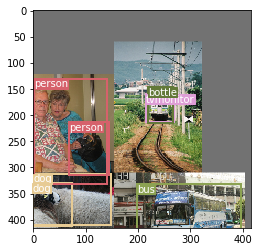

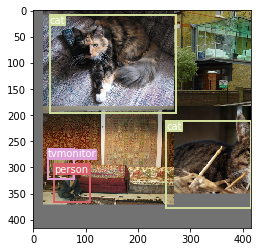

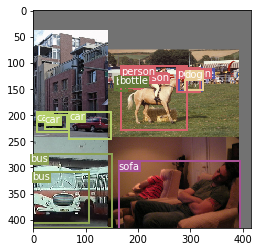

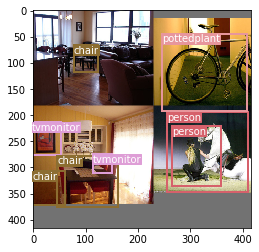

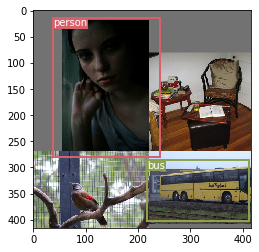

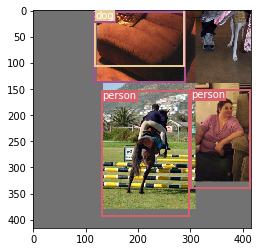

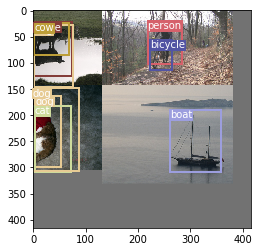

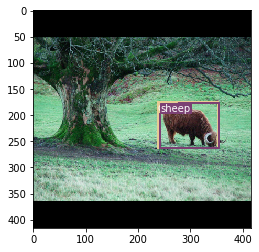

Current learning rate: 0.0006402798780487805
Currently epoch 18
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 56.409081%
No obj accuracy is: 97.464355%
Obj accuracy is: 61.179882%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

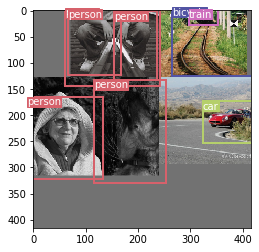

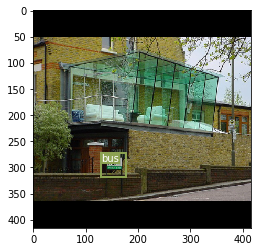

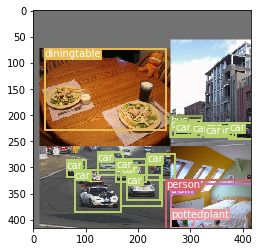

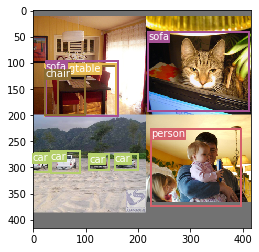

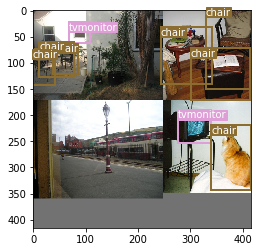

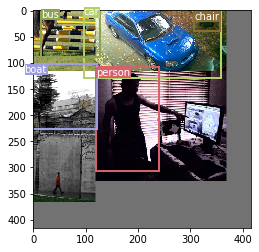

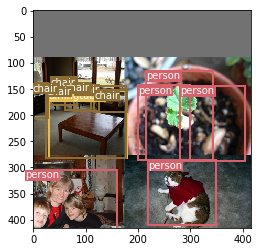

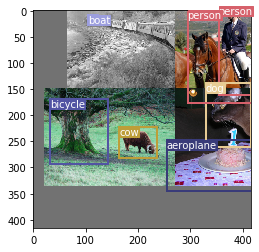

Current learning rate: 0.0006097951219512195
Currently epoch 19
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 62.732166%
No obj accuracy is: 97.448540%
Obj accuracy is: 68.533905%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

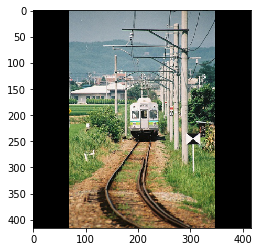

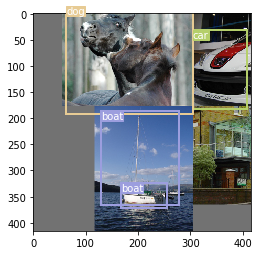

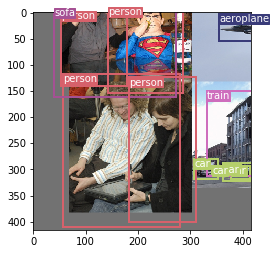

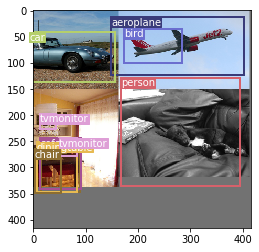

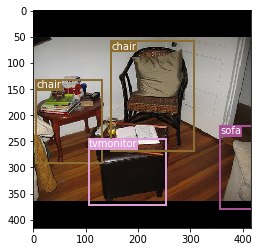

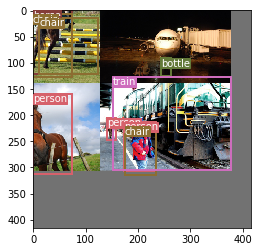

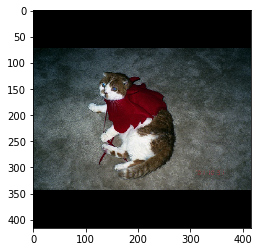

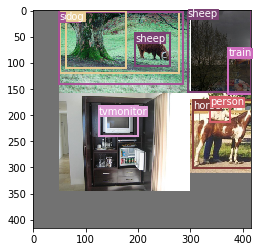

Current learning rate: 0.0005793103658536585
Currently epoch 20
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 64.855087%
No obj accuracy is: 96.954582%
Obj accuracy is: 70.110390%
=> Saving checkpoint
~~~~~~~~~Evaluating for val set~~~~~~~~~~~~~~~


  0%|          | 0/155 [00:00<?, ?it/s]

Class accuracy is: 68.537651%
No obj accuracy is: 97.161171%
Obj accuracy is: 70.078407%


  0%|          | 0/155 [00:00<?, ?it/s]

MAP: 0.25065523386001587


Validation: 0it [00:00, ?it/s]

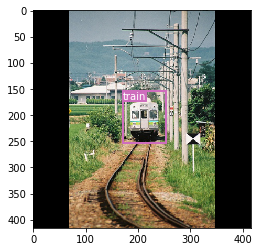

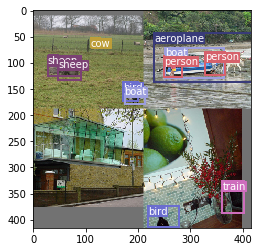

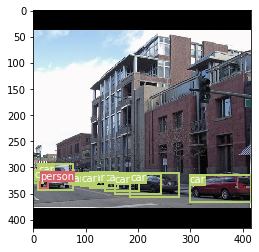

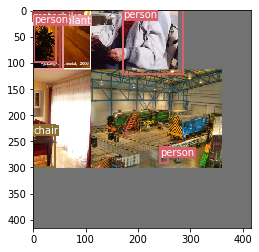

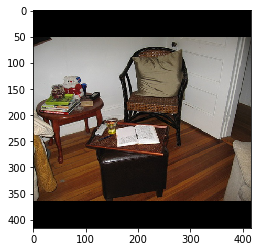

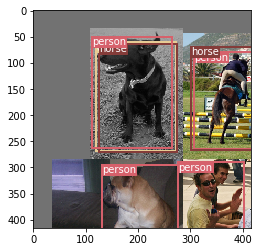

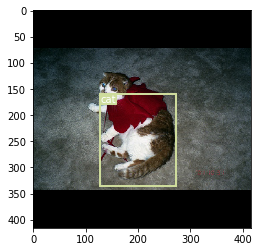

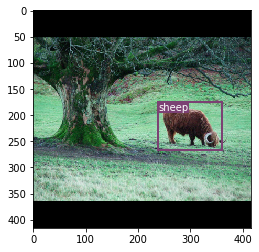

Current learning rate: 0.0005488256097560976
Currently epoch 21
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 67.070221%
No obj accuracy is: 97.885826%
Obj accuracy is: 66.441147%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

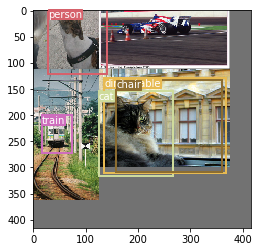

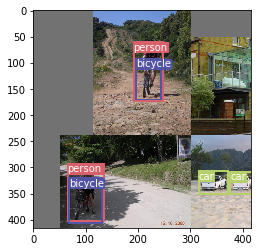

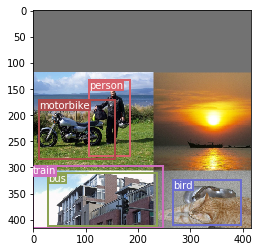

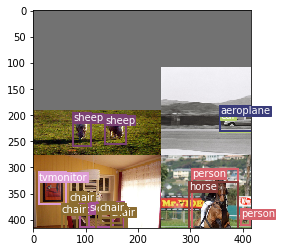

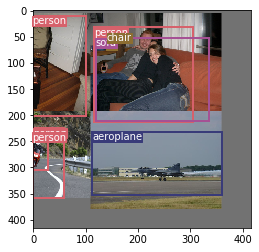

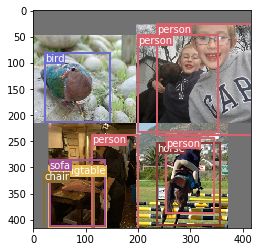

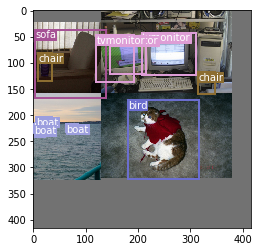

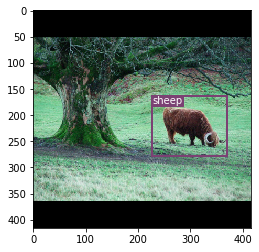

Current learning rate: 0.0005183408536585366
Currently epoch 22
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 69.835381%
No obj accuracy is: 97.793686%
Obj accuracy is: 67.204483%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

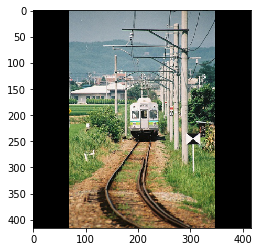

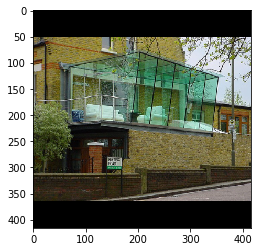

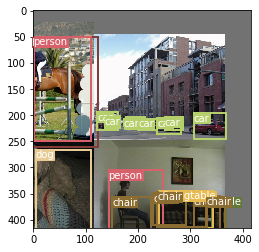

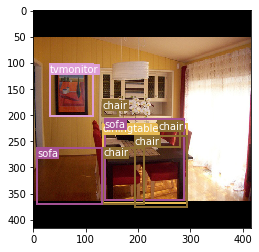

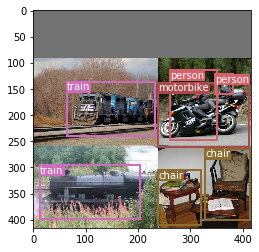

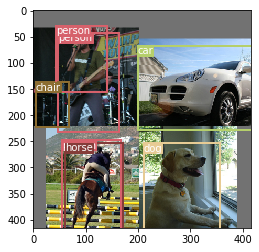

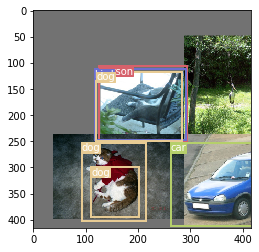

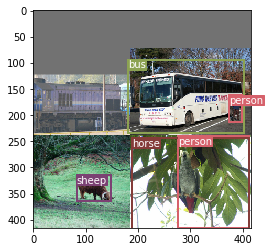

Current learning rate: 0.00048785609756097563
Currently epoch 23
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 70.744736%
No obj accuracy is: 97.101448%
Obj accuracy is: 73.996887%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

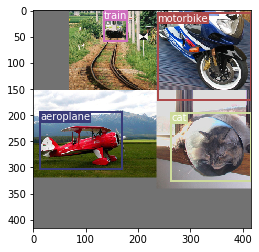

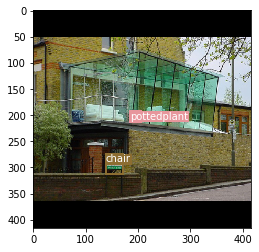

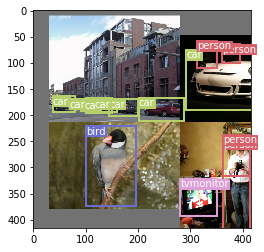

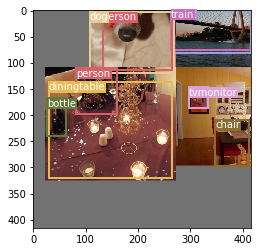

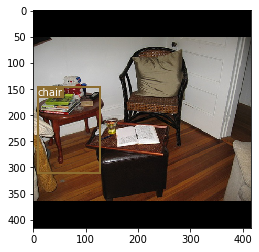

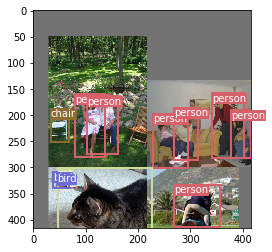

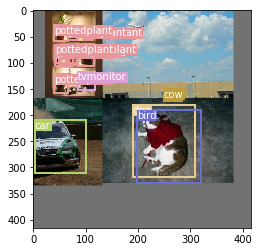

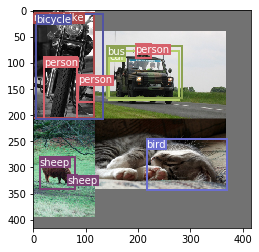

Current learning rate: 0.00045737134146341476
Currently epoch 24
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 72.403076%
No obj accuracy is: 97.559387%
Obj accuracy is: 72.890297%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

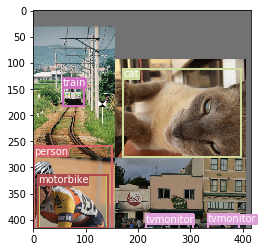

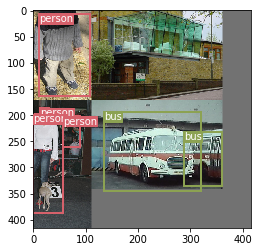

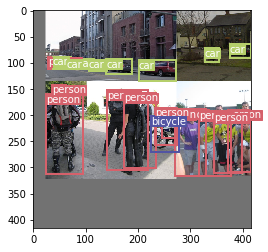

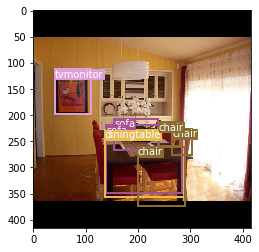

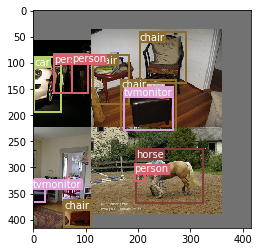

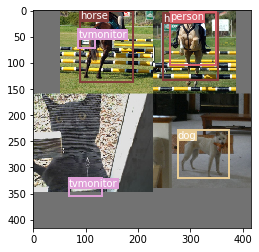

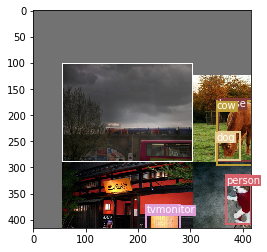

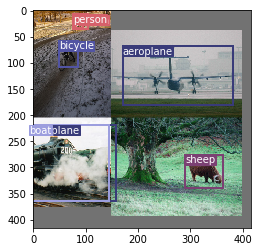

Current learning rate: 0.0004268865853658538
Currently epoch 25
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 72.506653%
No obj accuracy is: 97.937759%
Obj accuracy is: 70.023758%
=> Saving checkpoint
~~~~~~~~~Evaluating for val set~~~~~~~~~~~~~~~


  0%|          | 0/155 [00:00<?, ?it/s]

Class accuracy is: 74.594131%
No obj accuracy is: 97.821335%
Obj accuracy is: 71.411209%


  0%|          | 0/155 [00:00<?, ?it/s]

MAP: 0.33123230934143066


Validation: 0it [00:00, ?it/s]

Traceback (most recent call last):
  File "/opt/conda/lib/python3.7/multiprocessing/util.py", line 277, in _run_finalizers
    finalizer()
  File "/opt/conda/lib/python3.7/multiprocessing/util.py", line 201, in __call__
    res = self._callback(*self._args, **self._kwargs)
  File "/opt/conda/lib/python3.7/multiprocessing/util.py", line 110, in _remove_temp_dir
    rmtree(tempdir)
  File "/opt/conda/lib/python3.7/shutil.py", line 498, in rmtree
    onerror(os.rmdir, path, sys.exc_info())
  File "/opt/conda/lib/python3.7/shutil.py", line 496, in rmtree
    os.rmdir(path)
OSError: [Errno 39] Directory not empty: '/tmp/pymp-mnwzxn7u'


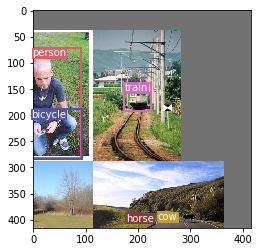

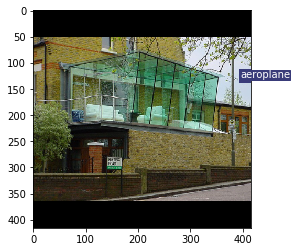

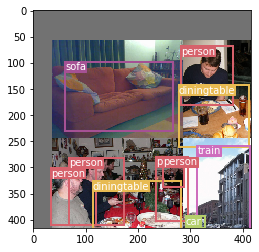

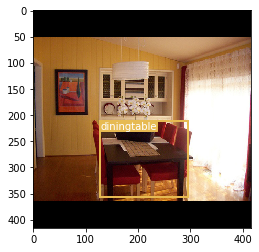

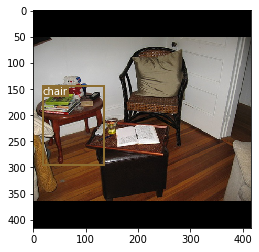

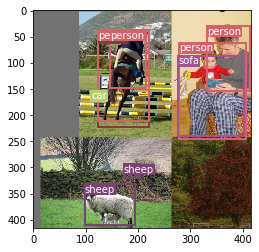

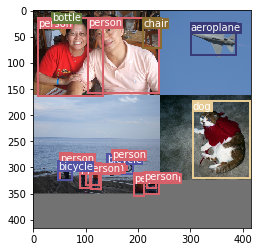

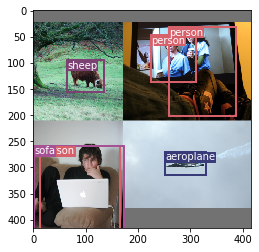

Current learning rate: 0.0003964018292682927
Currently epoch 26
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 75.397247%
No obj accuracy is: 98.083046%
Obj accuracy is: 71.053383%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

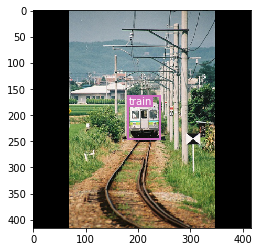

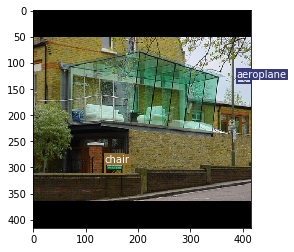

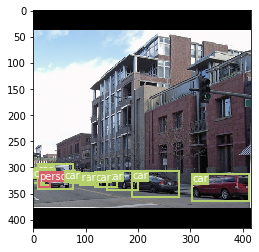

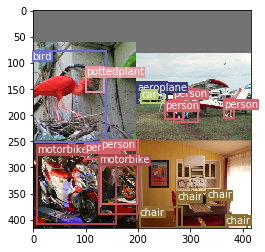

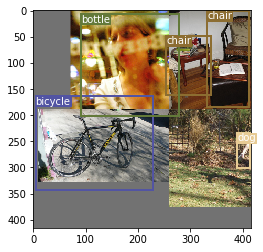

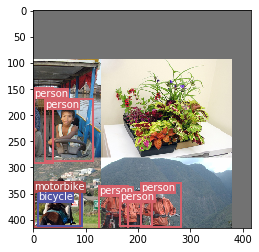

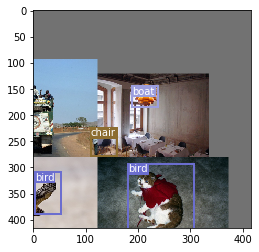

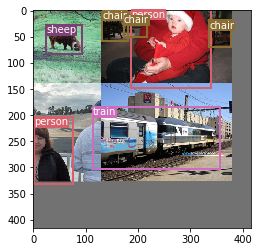

Current learning rate: 0.00036591707317073173
Currently epoch 27
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 74.668198%
No obj accuracy is: 98.021347%
Obj accuracy is: 69.638397%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

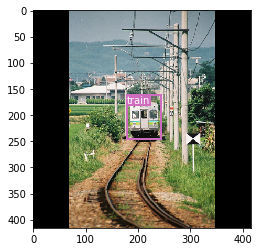

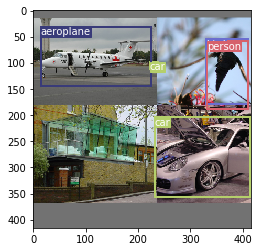

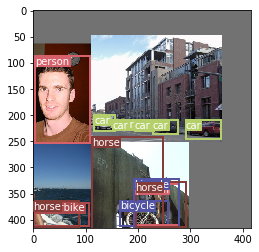

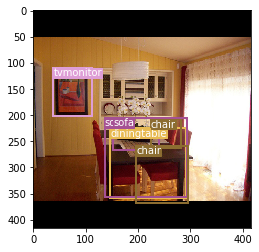

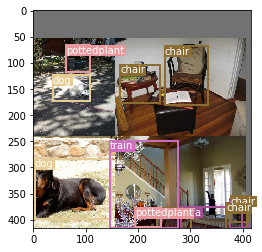

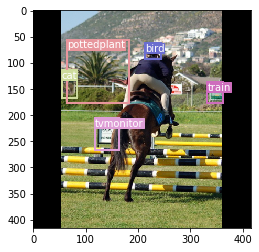

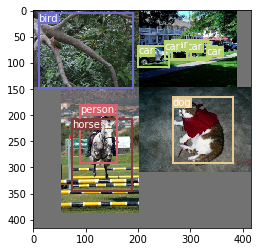

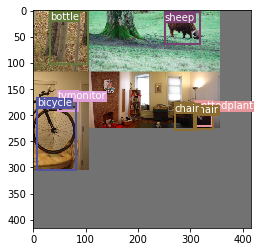

Current learning rate: 0.00033543231707317087
Currently epoch 28
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 76.731583%
No obj accuracy is: 97.827492%
Obj accuracy is: 73.003258%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

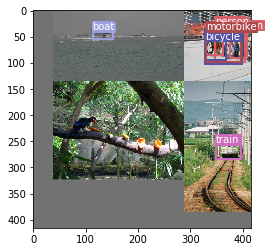

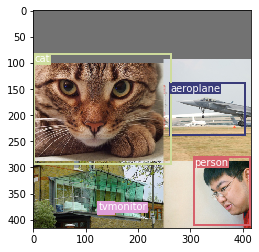

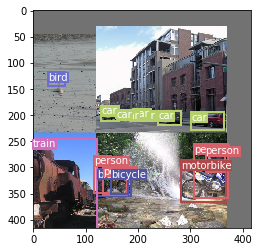

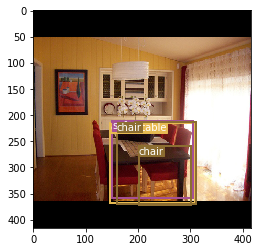

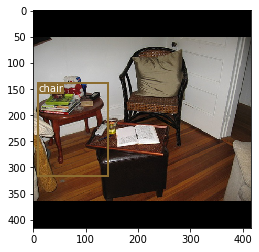

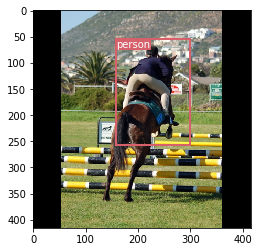

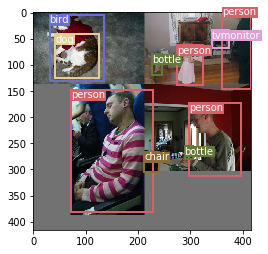

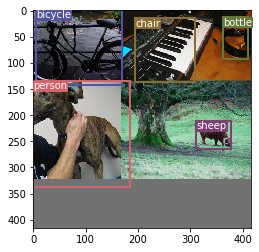

Current learning rate: 0.0003049475609756099
Currently epoch 29
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 77.948936%
No obj accuracy is: 97.863029%
Obj accuracy is: 74.076050%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

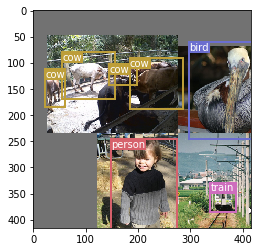

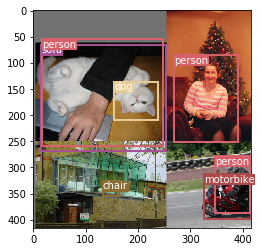

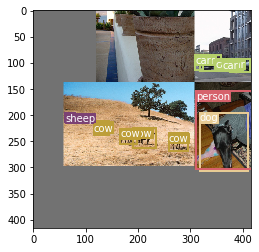

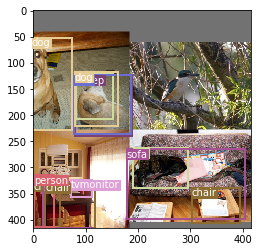

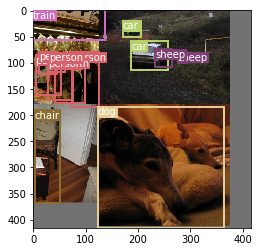

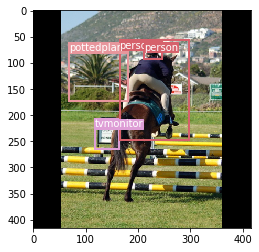

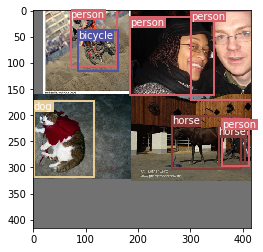

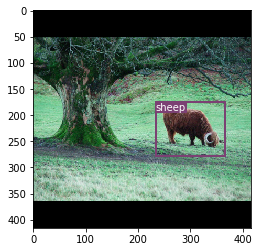

Current learning rate: 0.0002744628048780488
Currently epoch 30
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 78.747910%
No obj accuracy is: 97.733551%
Obj accuracy is: 76.218948%
=> Saving checkpoint
~~~~~~~~~Evaluating for val set~~~~~~~~~~~~~~~


  0%|          | 0/155 [00:00<?, ?it/s]

Class accuracy is: 80.344414%
No obj accuracy is: 97.604874%
Obj accuracy is: 76.256371%


  0%|          | 0/155 [00:00<?, ?it/s]

MAP: 0.4074838161468506


Validation: 0it [00:00, ?it/s]

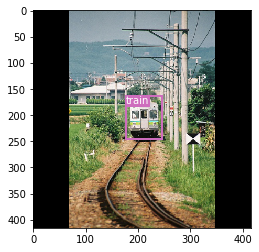

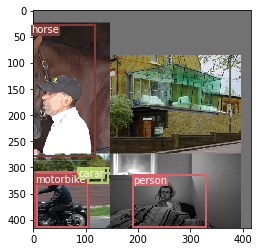

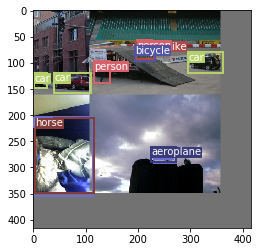

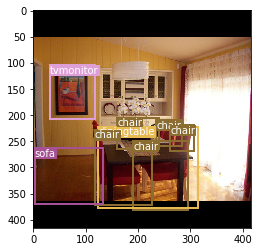

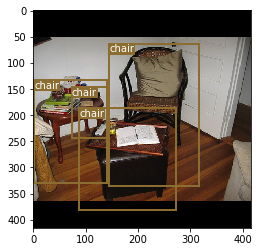

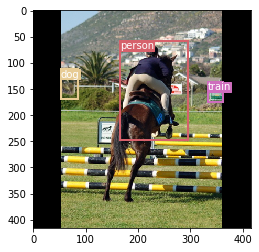

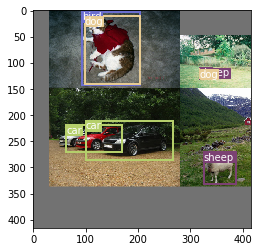

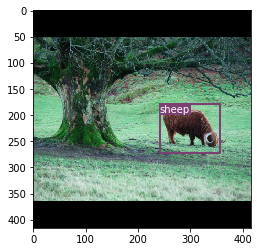

Current learning rate: 0.00024397804878048784
Currently epoch 31
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 80.092400%
No obj accuracy is: 97.719109%
Obj accuracy is: 77.048721%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

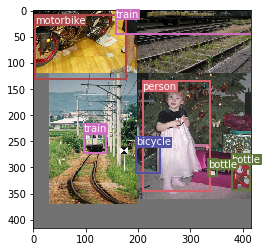

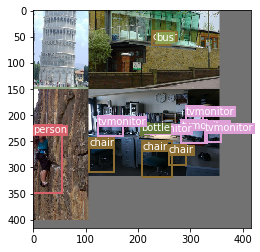

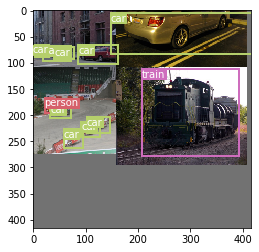

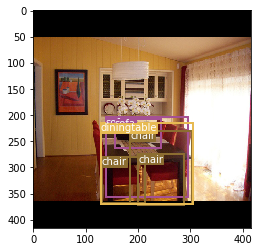

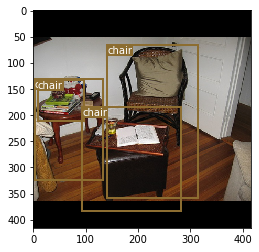

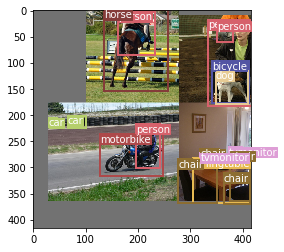

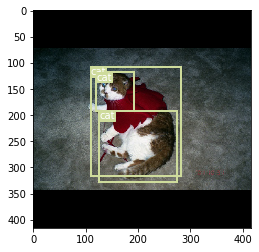

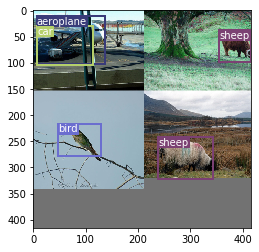

Current learning rate: 0.00021349329268292687
Currently epoch 32
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 80.842407%
No obj accuracy is: 97.966049%
Obj accuracy is: 76.967201%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

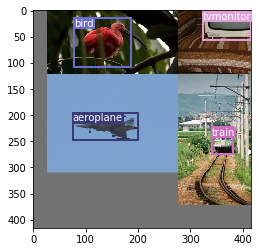

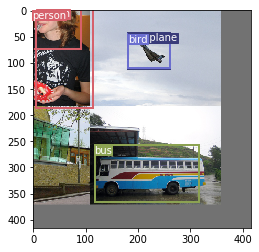

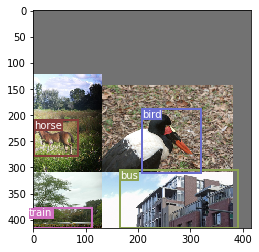

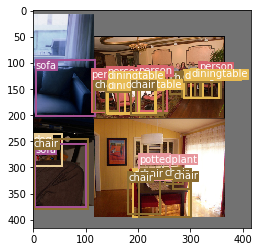

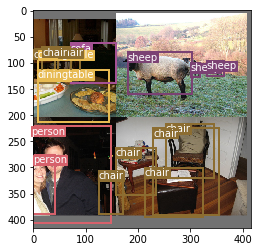

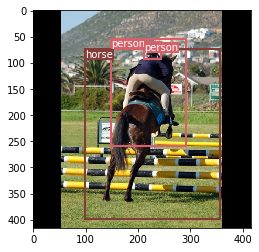

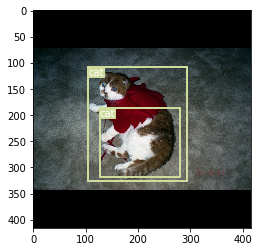

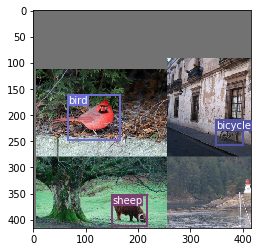

Current learning rate: 0.000183008536585366
Currently epoch 33
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 81.718513%
No obj accuracy is: 97.940033%
Obj accuracy is: 77.389297%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

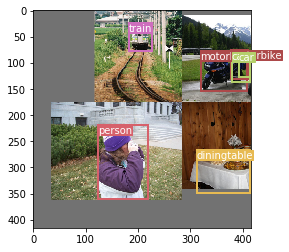

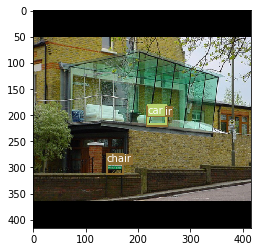

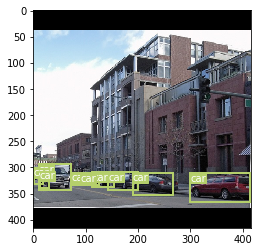

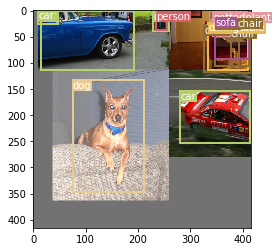

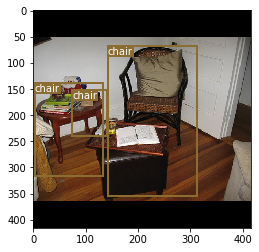

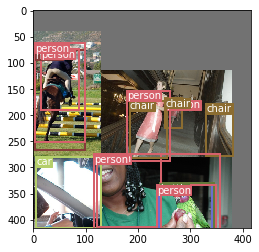

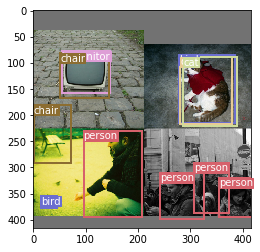

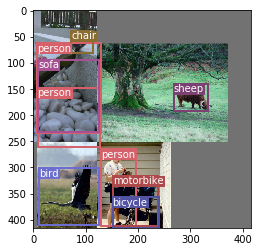

Current learning rate: 0.00015252378048780492
Currently epoch 34
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 82.824303%
No obj accuracy is: 97.939301%
Obj accuracy is: 78.430611%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

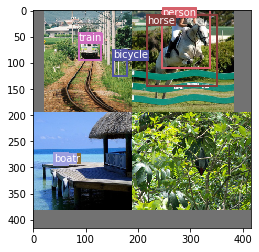

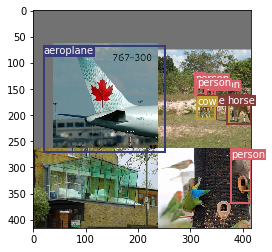

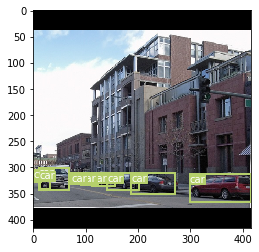

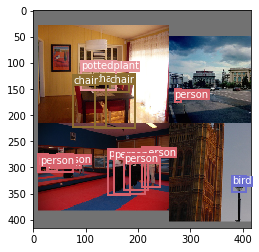

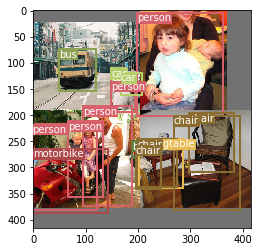

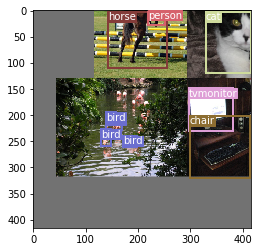

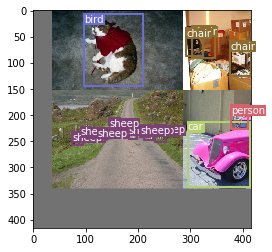

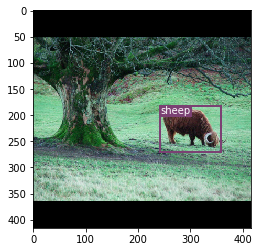

Current learning rate: 0.00012203902439024395
Currently epoch 35
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 83.134720%
No obj accuracy is: 98.107834%
Obj accuracy is: 77.625366%
=> Saving checkpoint
~~~~~~~~~Evaluating for val set~~~~~~~~~~~~~~~


  0%|          | 0/155 [00:00<?, ?it/s]

Class accuracy is: 81.628212%
No obj accuracy is: 98.066238%
Obj accuracy is: 76.097694%


  0%|          | 0/155 [00:00<?, ?it/s]

MAP: 0.43761777877807617


Validation: 0it [00:00, ?it/s]

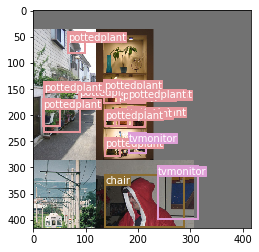

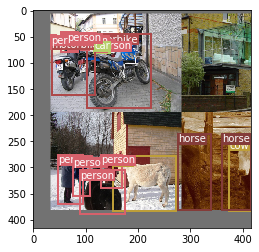

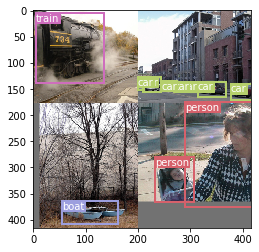

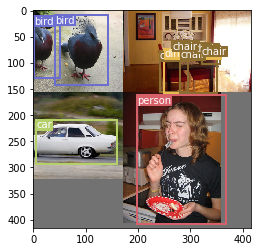

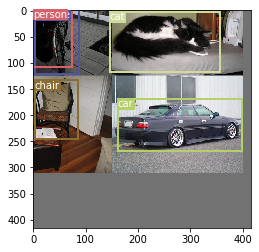

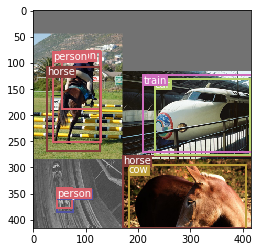

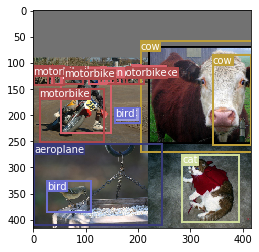

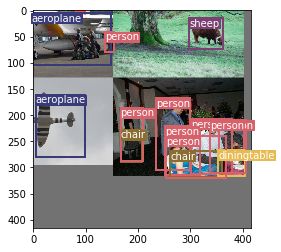

Current learning rate: 9.155426829268298e-05
Currently epoch 36
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 84.922821%
No obj accuracy is: 97.938927%
Obj accuracy is: 79.901649%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

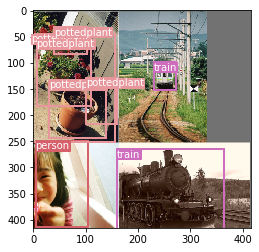

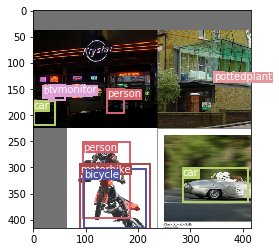

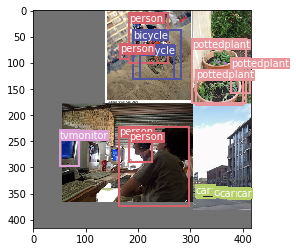

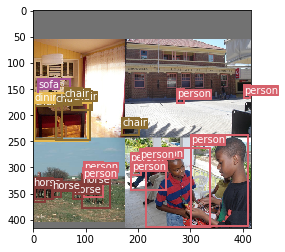

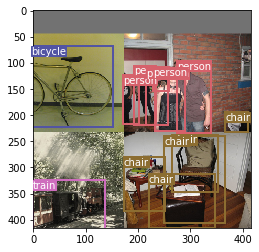

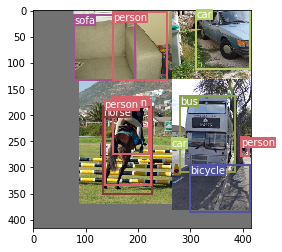

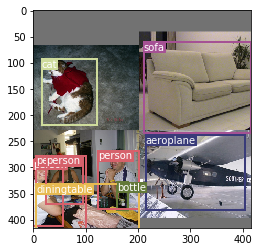

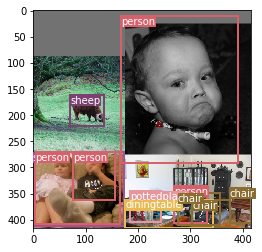

Current learning rate: 6.106951219512211e-05
Currently epoch 37
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 85.833313%
No obj accuracy is: 98.028580%
Obj accuracy is: 79.615295%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

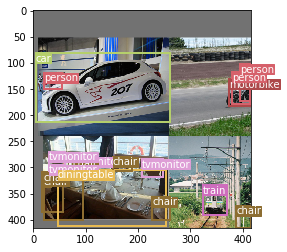

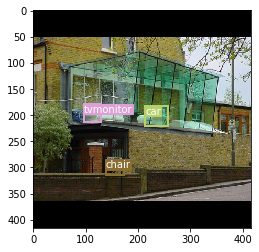

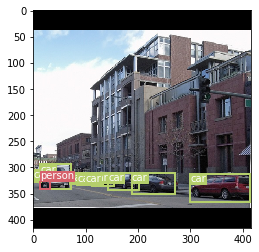

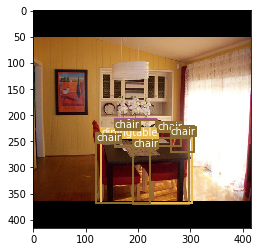

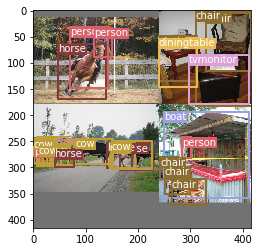

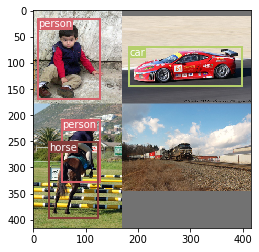

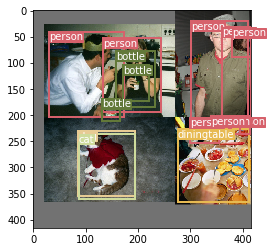

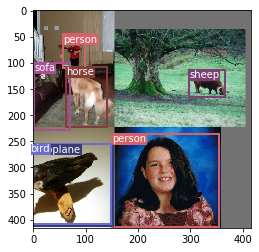

Current learning rate: 3.058475609756103e-05
Currently epoch 38
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 86.234322%
No obj accuracy is: 98.010452%
Obj accuracy is: 80.608116%
=> Saving checkpoint


Validation: 0it [00:00, ?it/s]

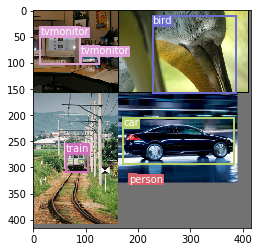

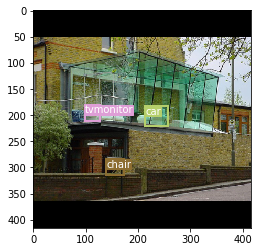

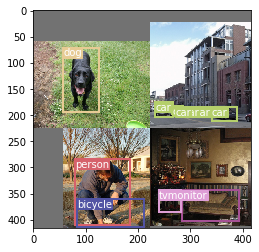

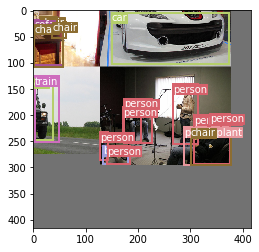

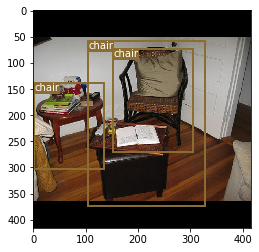

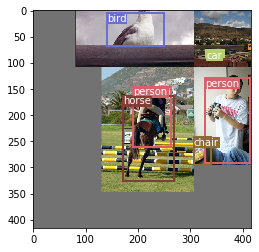

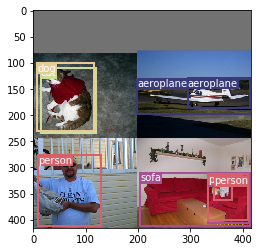

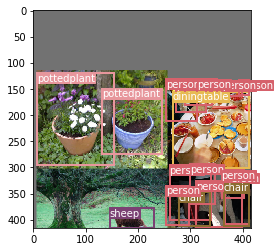

Current learning rate: 1.0000000000005664e-07
Currently epoch 39
On Train Eval loader:
On Train loader:


  0%|          | 0/518 [00:00<?, ?it/s]

Class accuracy is: 86.898766%
No obj accuracy is: 98.085403%
Obj accuracy is: 80.370033%
=> Saving checkpoint


`Trainer.fit` stopped: `max_epochs=40` reached.


In [3]:
from pytorch_lightning.callbacks import ModelCheckpoint
from pytorch_lightning.callbacks import LearningRateMonitor
lr_monitor = LearningRateMonitor(logging_interval='step')
trainer = Trainer(
    gpus=1,
    precision = 16,
    max_epochs = config.NUM_EPOCHS,
    callbacks=[lr_monitor]
)
model = Yolov3_module()
# Train the PyTorch Lightning model
trainer.fit(model)

# Testing last epoch checkpoint on test dataset

In [7]:
from utils import (load_checkpoint,get_evaluation_bboxes,check_class_accuracy,mean_average_precision)
from dataset import YOLODataset
model = Yolov3_module()
optimizer = torch.optim.Adam(model.parameters(), lr=config.LEARNING_RATE, weight_decay=config.WEIGHT_DECAY)
load_checkpoint(
        'checkpoints/39checkpoint.pth.tar', model, optimizer, config.LEARNING_RATE
    )
model = model.to(DEVICE)
test_dataset = YOLODataset(
          config.DATASET + "/test.csv",
          transform=config.test_transforms,
          S=[config.IMAGE_SIZE // 32, config.IMAGE_SIZE // 16, config.IMAGE_SIZE // 8],
          img_dir=config.IMG_DIR,
          label_dir=config.LABEL_DIR,
          anchors=config.ANCHORS,
          )
test_dataloader = DataLoader(test_dataset, batch_size=config.BATCH_SIZE, num_workers=config.NUM_WORKERS)
check_class_accuracy(model, test_dataloader, threshold=config.CONF_THRESHOLD)
pred_boxes, true_boxes = get_evaluation_bboxes(
                test_dataloader,
                model,
                iou_threshold=config.NMS_IOU_THRESH,
                anchors=config.ANCHORS,
                threshold=config.CONF_THRESHOLD,
            )
mapval = mean_average_precision(
                pred_boxes,
                true_boxes,
                iou_threshold=config.MAP_IOU_THRESH,
                box_format="midpoint",
                num_classes=config.NUM_CLASSES,
            )
print(f"MAP: {mapval.item()}")

=> Loading checkpoint


  0%|          | 0/155 [00:00<?, ?it/s]

Class accuracy is: 84.441826%
No obj accuracy is: 98.041069%
Obj accuracy is: 79.294098%


  0%|          | 0/155 [00:00<?, ?it/s]

MAP: 0.5066007375717163


## generating prediction on single image

In [2]:
import matplotlib.patches as patches
import cv2
from albumentations.pytorch import ToTensorV2
from matplotlib import pyplot as plt
import numpy as np
from utils import YoloCAM, plot_couple_examples2
import torch
import config
from Model.Moduli import Yolov3_module
from PIL import Image

image1 = Image.open("Images/puppies.png") #cv2.imread("Images/puppies.png")
nimg = np. array(image1)
image1 = cv2. cvtColor(nimg, cv2.COLOR_RGB2BGR)
checkpoint_file = 'checkpoints/39checkpoint.pth.tar'
model = Yolov3_module()
checkpoint = torch.load(checkpoint_file, map_location="cpu")
model.load_state_dict(checkpoint["state_dict"])
model.eval()
cam = YoloCAM(model=model, target_layers=[model.model.layers[-2]], use_cuda=False)
scaled_anchors = (
    torch.tensor(config.ANCHORS)
    * torch.tensor(config.S).unsqueeze(1).unsqueeze(1).repeat(1, 3, 2)
)

out2in, cam_image = plot_couple_examples2(model, config.transforms, image1, scaled_anchors, cam)

/opt/conda/lib/python3.7/site-packages/pkg_resources/__init__.py:119: PkgResourcesDeprecationWarning: 4.0.0-unsupported is an invalid version and will not be supported in a future release
  PkgResourcesDeprecationWarning,
/opt/conda/lib/python3.7/site-packages/pkg_resources/__init__.py:119: PkgResourcesDeprecationWarning: 4.0.0-unsupported is an invalid version and will not be supported in a future release
  PkgResourcesDeprecationWarning,


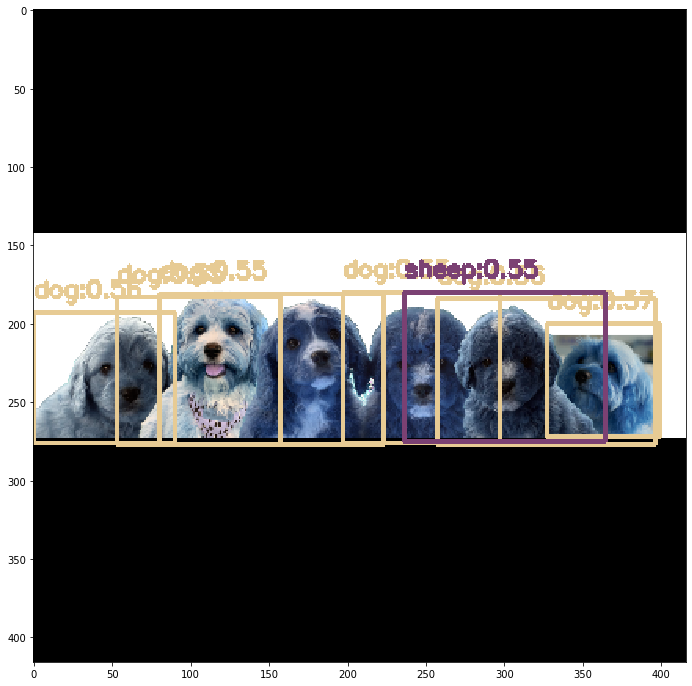

In [3]:
plt.figure(figsize=(20,12))
plt.imshow(out2in)

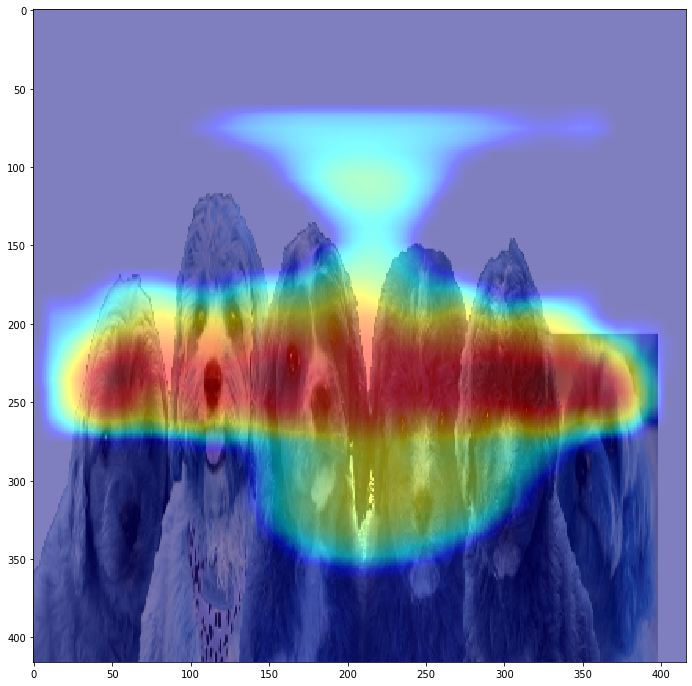

In [12]:
plt.figure(figsize=(20,12))
plt.imshow(cam_image)